In [1]:

import pandas as pd
import numpy as np

## Énoncé
En tant que Data Scientist vous venez de décrocher une mission avec une plateforme d'éducation en ligne leader sur le marché européen, vous allez bientôt signer le contrat et vous consacrer au sujet pour les deux prochaines semaines.

Ce leader de l'EdTech voit grand, ayant une forte implantation en France et en Europe, les dirigeants souhaitent également se développer sur le territoire américain qui regorge d'opportunités pour la formation en ligne, de par la taille de la population et des besoins liés aux métiers du numérique. L'entreprise souhaite démarrer son implantation aux USA en sélectionnant les territoires géographiques les plus prometteurs afin de lancer des campagnes publicitaires ciblées.

## Mission
Pour cette mission, on vous demande de déterminer la liste des villes prioritaires en vous basant sur des données récoltées par l'administration et disponibles en open-data. Votre objectif est de **fournir des résultats impactants** afin de guider Lesley en charge du développement pour la région Amérique du Nord.

Pour ce travail, votre client a identifié [une source de données](https://data.ed.gov/dataset/college-scorecard-all-data-files-through-6-2020/resources?resource=658b5b83-ac9f-4e41-913e-9ba9411d7967) intéressante et a déjà initié une sélection de variables, à vous de compléter l'étude.

# Exercice
## Partie 1 - Inspection des données (10 minutes)
<img src='./oc_logo.png' width=15px /> Chargez le fichier `edtech_market_study_usa.csv` à l'aide de Pandas. Stockez le résultat du chargement dans la variable `df`.

Les colonnes du fichier sont uniquement séparées par des virgules.

In [46]:
df = pd.read_csv('edtech_market_study_usa.csv', sep=',')


<img src='./oc_logo.png' width=15px /> Pouvez-vous afficher les 5 premières lignes du dataframe pour vérifier que les données sont bien chargées ?

In [3]:
df.head()

,ID,NOM,VILLE,ETAT,LATITUDE,LONGITUDE,A_DISTANCE_SEULEMENT,NOMBRE_ETUDIANTS,AGE_ENTREE,COUT_MOYEN_ANNEE_ACADEMIE,TAUX_ADMISSION,DEFAUT_PAIEMENT_2ANNEES,DEFAUT_PAIEMENT_3ANNEES
0,100200,Alabama A & M University,Normal,AL,34.783368,-86.568502,0.0,1368,20.283741368,22489.0,0.8986,0.114,0.182
1,105200,University of Alabama at Birmingham,Birmingham,AL,33.505697,-86.799345,0.0,2730,23.60797466,24347.0,0.9211,0.060,0.057
2,2503400,Amridge University,Montgomery,AL,32.362609,-86.174010,1.0,135,33.672297297,17680.0,NaN,0.071,0.110
3,105500,University of Alabama in Huntsville,Huntsville,AL,34.724557,-86.640449,0.0,1175,22.727919632,23441.0,0.8087,0.077,0.059
4,100500,Alabama State University,Montgomery,AL,32.364317,-86.295677,0.0,1281,20.130990415,21476.0,0.9774,0.132,0.203


<img src='./oc_logo.png' width=15px /> Combien de lignes et colonnes sont contenues dans `df` ?

In [4]:
df.shape 

(6806, 13)

 Il y'a 6809 lignes et 13 colonnes


<img src='./oc_logo.png' width=15px /> Affichez le type des colonnes

In [5]:
df.dtypes

ID                             int64
NOM                           object
VILLE                         object
ETAT                          object
LATITUDE                     float64
LONGITUDE                    float64
A_DISTANCE_SEULEMENT         float64
NOMBRE_ETUDIANTS              object
AGE_ENTREE                    object
COUT_MOYEN_ANNEE_ACADEMIE    float64
TAUX_ADMISSION               float64
DEFAUT_PAIEMENT_2ANNEES      float64
DEFAUT_PAIEMENT_3ANNEES      float64
dtype: object

<img src='./oc_logo.png' width=15px /> Les deux colonnes `NOMBRE_ETUDIANTS` et `AGE_ENTREE` ne sont pas bien typées, corrigez cela.

In [6]:
# la colonne contient une valeur string ce qui empêche la conversion en entier
df.loc[df['NOMBRE_ETUDIANTS'] == 'PrivacySuppressed', 'NOMBRE_ETUDIANTS'] = np.nan # remplace la valeur 'PrivacySuppressed' par NaN
# la colonne contient une valeur string ce qui empêche la conversion en entier
df.loc[df['AGE_ENTREE'] == 'PrivacySuppressed', 'AGE_ENTREE'] = np.nan # remplace la valeur 'PrivacySuppressed' par NaN
df['NOMBRE_ETUDIANTS'] = pd.to_numeric(df['NOMBRE_ETUDIANTS']) # convertit la colonne en entier
df['AGE_ENTREE'] = pd.to_numeric(df['AGE_ENTREE']) # convertit la colonne en entier

In [7]:
df.dtypes

ID                             int64
NOM                           object
VILLE                         object
ETAT                          object
LATITUDE                     float64
LONGITUDE                    float64
A_DISTANCE_SEULEMENT         float64
NOMBRE_ETUDIANTS             float64
AGE_ENTREE                   float64
COUT_MOYEN_ANNEE_ACADEMIE    float64
TAUX_ADMISSION               float64
DEFAUT_PAIEMENT_2ANNEES      float64
DEFAUT_PAIEMENT_3ANNEES      float64
dtype: object

<img src='./oc_logo.png' width=15px /> Existe-t-il des valeurs manquantes dans ce jeu de données ?

In [8]:
df.isnull().sum() 

ID                              0
NOM                             0
VILLE                           0
ETAT                            0
LATITUDE                      475
LONGITUDE                     475
A_DISTANCE_SEULEMENT          475
NOMBRE_ETUDIANTS              747
AGE_ENTREE                    626
COUT_MOYEN_ANNEE_ACADEMIE    3375
TAUX_ADMISSION               4800
DEFAUT_PAIEMENT_2ANNEES      1296
DEFAUT_PAIEMENT_3ANNEES       927
dtype: int64

In [9]:
df.isnull().mean() * 100  # Pourcentage

ID                            0.000000
NOM                           0.000000
VILLE                         0.000000
ETAT                          0.000000
LATITUDE                      6.979136
LONGITUDE                     6.979136
A_DISTANCE_SEULEMENT          6.979136
NOMBRE_ETUDIANTS             10.975610
AGE_ENTREE                    9.197767
COUT_MOYEN_ANNEE_ACADEMIE    49.588598
TAUX_ADMISSION               70.526006
DEFAUT_PAIEMENT_2ANNEES      19.042022
DEFAUT_PAIEMENT_3ANNEES      13.620335
dtype: float64


[notice] A new release of pip is available: 24.0 -> 25.1.1
[notice] To update, run: C:\Users\ngale\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


<Axes: >

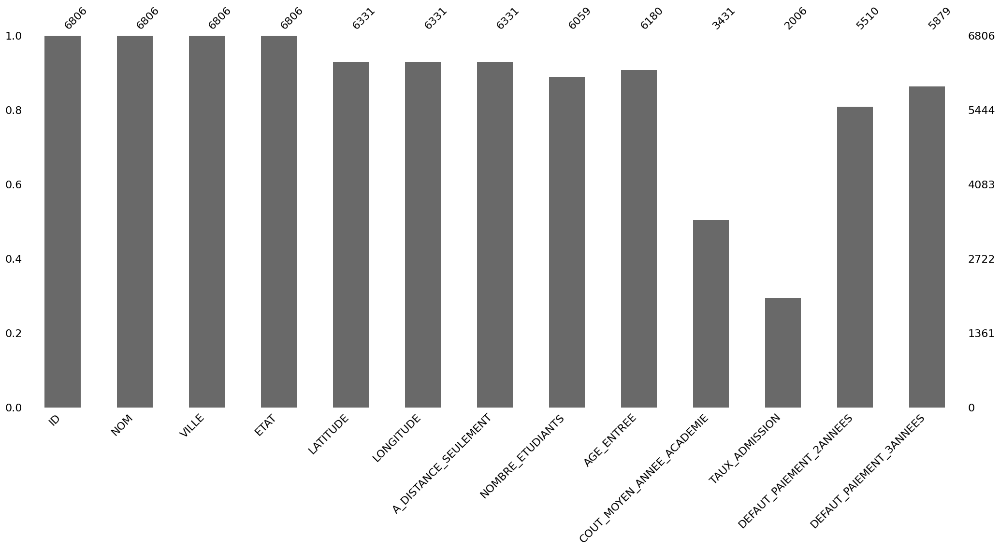

In [10]:
!pip install missingno
import missingno as msno # pour visualiser les valeurs manquantes
msno.bar(df)

Ils existent des valeurs manquantes dans 9 colonnes 

<img src='./oc_logo.png' width=15px /> Vérifions s'il existe des doublons pour la variable ID qui est un identifiant unique

In [11]:
df['ID'].duplicated().sum() 

np.int64(30)

 Il n'existe 30 doublons dans la colonne ID 

<img src='./oc_logo.png' width=15px /> Nous allons maintenant nous débarrasser des duplicatas en supprimant la version la moins bien renseignée

In [12]:
# on compte le nombre de valeurs manquantes pour la ligne et on stocke dans une nouvelle colonne
df['NB_NAN'] = df.isna().sum(axis=1)
# trie des lignes en fonction du nombre de valeurs manquantes
df = df.sort_values('NB_NAN')
# suppression des duplicatas en gardant les versions les mieux remplies
df = df.drop_duplicates('ID', keep='first')
# on supprime la colonne qui n'est plus utile
df = df.drop('NB_NAN', axis=1)

In [13]:
# on compte le nombre de valeurs manquantes pour la ligne et on stocke dans une nouvelle colonne
df['NB_NAN'] = df.isna().sum(axis=1)
# trie des lignes en fonction du nombre de valeurs manquantes
df2 = df.sort_values('NB_NAN')
df2

,ID,NOM,VILLE,ETAT,LATITUDE,LONGITUDE,A_DISTANCE_SEULEMENT,NOMBRE_ETUDIANTS,AGE_ENTREE,COUT_MOYEN_ANNEE_ACADEMIE,TAUX_ADMISSION,DEFAUT_PAIEMENT_2ANNEES,DEFAUT_PAIEMENT_3ANNEES,NB_NAN
3217,350100,Le Moyne-Owen College,Memphis,TN,35.118641,-90.034101,0.0,386.0,23.534819,17758.0,0.9284,0.159,0.233,0
3214,349600,King University,Bristol,TN,36.585309,-82.159421,0.0,966.0,29.816657,40864.0,0.5813,0.044,0.067,0
3805,502600,Inter American University of Puerto Rico-Arecibo,Arecibo,PR,18.475090,-66.759010,0.0,1384.0,22.646230,13476.0,0.2828,0.164,0.027,0
3804,393900,Inter American University of Puerto Rico-Aguad...,Aguadilla,PR,18.467886,-67.121671,0.0,1455.0,22.174746,13284.0,0.4640,0.164,0.027,0
3803,4254200,Inter American University of Puerto Rico-San G...,San German,PR,18.083530,-67.050820,0.0,1312.0,21.450378,14322.0,0.4525,0.164,0.033,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6669,1005303,Indian Capital Technology Center-Tahlequah,Tahlequah,OK,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9
6755,4164701,Keweenaw Bay Ojibwa Community College - Wabanu...,L'Anse,MI,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9
6668,1005302,Indian Capital Technology Center-Stilwell,Stilwell,OK,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9
6805,4227001,ABC Adult School - Cabrillo Lane,Cerritos,CA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9


## Partie 2 - Exploration (2 heures)

<img src='./oc_logo.png' width=15px /> Combien d'établissements sont représentés dans ce fichier ?

In [14]:
df["NOM"].nunique() # Nombre de valeurs uniques dans la colonne NOM

6648

Il y'a 6678 établissement représenter dans ce dataframe  

<img src='./oc_logo.png' width=15px /> On souhaite savoir si la couverture des états est représentative, à savoir si le nombre d'établissements est significatif. **Donnez le nombre d'établissements par état**.

In [15]:
df3= df.groupby(df["ETAT"]).agg({"NOM": "count"}) # Nombre de valeurs uniques dans la colonne NOM par ETAT
df3

,NOM
ETAT,
AK,9
AL,85
AR,92
AS,1
AZ,117
CA,701
CO,109
CT,80
DC,22


Nous constatons que l'Etat AK a 9 établissement etc...

<img src='./oc_logo.png' width=15px /> Suite aux résultats de la question précédente, pensez-vous qu'il est normal que certains états possèdent si peu d'établissements ? Voici [un lien intéressant](https://www.factmonster.com/us/postal-information/state-abbreviations-and-state-postal-codes). 

Identifiez les états avec moins de 5 établissements éducatifs.

In [16]:
df3[df3["NOM"]<5].index 

Index(['AS', 'FM', 'GU', 'MH', 'MP', 'PW', 'VI'], dtype='object', name='ETAT')

<img src='./oc_logo.png' width=15px /> Supprimez les établissements situés dans ces états, nos résultats risquent de ne pas être assez représentatifs si on les exploite.

In [17]:
df.drop(df[df["ETAT"].isin(df3[df3["NOM"]<5].index)].index,inplace=True) # a tarvers se sous dataframe: df[df["ETAT"].isin(df3[df3["NOM"]<5].index)] on récupère les index(lignes) avec le .index puis on les supprime avec le drop qui va nous permettre de supprimer les lignes contenant des valeurs(modalités) que on veut supprimer

In [18]:
# verification de la suppression a travers les index de ces modalités
df[df["ETAT"].isin(df3[df3["NOM"]<5].index)].index


Index([], dtype='int64')

Nous constatons que les Etats contenant moins d'établissement ont été supprimer du dataframe 

<img src='./oc_logo.png' width=15px /> Quels sont les 3 états qui hébergent le plus d'établissements fonctionnant en mode à distance ?

In [19]:
df["A_DISTANCE_SEULEMENT"].value_counts() # on compte le nombre de valeurs uniques dans la colonne A_DISTANCE_SEULEMENT

A_DISTANCE_SEULEMENT
0.0    6253
1.0      44
Name: count, dtype: int64

In [20]:
# Quels sont les 3 états qui hébergent le plus d'établissements fonctionnant en mode à distance 
df.groupby(df["ETAT"]).agg({"NOM": "count","A_DISTANCE_SEULEMENT":"sum"}).sort_values("A_DISTANCE_SEULEMENT", ascending=False).head(3)


,NOM,A_DISTANCE_SEULEMENT
ETAT,,
CA,701,9.0
AZ,117,4.0
CO,109,3.0


Par rapport à l'analyse nous constatons que l'Etat CA contient plus de 9 établissement en ligne, Etat AZ contient 4 établissement en ligne etc..
Nous pouvons aussi dire que l'Etat CA contient 693 établissement non en ligne

<img src='./oc_logo.png' width=15px /> Nous allons exploiter le taux de défaut de paiement de l'établissement pour se renseigner sur le potentiel local d'une formation à coût inférieur. 

Faites une moyenne des variables `DEFAUT_PAIEMENT_2ANNEES` et `DEFAUT_PAIEMENT_3ANNEES`, stockez le résultat dans une nouvelle colonne `DEFAUT_PAIEMENT`.

In [21]:
df["DEFAUT_PAIEMENT"] = (df["DEFAUT_PAIEMENT_2ANNEES"] + df["DEFAUT_PAIEMENT_3ANNEES"])/2

In [22]:
df.head()

,ID,NOM,VILLE,ETAT,LATITUDE,LONGITUDE,A_DISTANCE_SEULEMENT,NOMBRE_ETUDIANTS,AGE_ENTREE,COUT_MOYEN_ANNEE_ACADEMIE,TAUX_ADMISSION,DEFAUT_PAIEMENT_2ANNEES,DEFAUT_PAIEMENT_3ANNEES,NB_NAN,DEFAUT_PAIEMENT
3230,351000,Middle Tennessee State University,Murfreesboro,TN,35.848005,-86.360618,0.0,4613.0,22.357583,20718.0,0.9353,0.085,0.103,0,0.0940
8,831000,Auburn University at Montgomery,Montgomery,AL,32.367360,-86.177544,0.0,1175.0,22.199804,18291.0,0.9281,0.090,0.104,0,0.0970
9,100900,Auburn University,Auburn,AL,32.599378,-85.488258,0.0,3032.0,20.516796,31282.0,0.7543,0.045,0.036,0,0.0405
10,101200,Birmingham-Southern College,Birmingham,AL,33.513774,-86.850552,0.0,208.0,19.644796,52176.0,0.5666,0.085,0.048,0,0.0665
21,962107,Herzing University-Birmingham,Birmingham,AL,33.468466,-86.832465,0.0,4088.0,31.289941,26128.0,0.9500,0.117,0.127,0,0.1220


<img src='./oc_logo.png' width=15px /> Remplacez les valeurs manquantes de la colonne `DEFAUT_PAIEMENT` par zéro.

In [23]:
df["DEFAUT_PAIEMENT"].fillna(0, inplace=True) # remplace les valeurs manquantes par 0

C:\Users\ngale\AppData\Local\Temp\ipykernel_4444\913033505.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df["DEFAUT_PAIEMENT"].fillna(0, inplace=True) # remplace les valeurs manquantes par 0


<img src='./oc_logo.png' width=15px /> Il serait intéressant de connaître le nombre d'étudiants potentiels par ville dans le but de cibler prioritairement les plus peuplées, une hypothétique opération publicitaire serait alors plus rentable.

Pour retrouver le nombre d'étudiants ayant fait une demande d'inscription, nous allons nous baser sur le nombre d'étudiants acceptés et sur le taux d'admission. 

Dans un premier temps remplacez les taux d'admission manquants par la valeur médiane de la variable.

In [24]:
df["TAUX_ADMISSION"].fillna(df["TAUX_ADMISSION"].median(), inplace=True) # remplace les valeurs manquantes par la median de la colonne

C:\Users\ngale\AppData\Local\Temp\ipykernel_4444\1627648922.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df["TAUX_ADMISSION"].fillna(df["TAUX_ADMISSION"].median(), inplace=True) # remplace les valeurs manquantes par la median de la colonne


Nous constatons que la variable TAUX D'ADMISSION ne contient plus de valeur manquante 

<img src='./oc_logo.png' width=15px /> Supprimez les lignes ayant un taux d'admission nul, cela paraît peu probable.

In [25]:
df["TAUX_ADMISSION"].unique() # on compte le nombre de valeurs uniques dans la colonne TAUX_ADMISSION

array([0.9353, 0.9281, 0.7543, ..., 0.3599, 0.5028, 0.1146])

In [26]:
df.drop(df[df["TAUX_ADMISSION"]==0].index,inplace=True) # on supprime les lignes contenant des valeurs nulles dans la colonne TAUX_ADMISSION

<img src='./oc_logo.png' width=15px /> Remplacez les valeurs manquantes de la colonne `NOMBRE_ETUDIANTS` en remplaçant par la valeur médiane de la variable.

In [27]:
df["NOMBRE_ETUDIANTS"].fillna(df["NOMBRE_ETUDIANTS"].median(), inplace=True) # remplace les valeurs manquantes par la median de la colonne

C:\Users\ngale\AppData\Local\Temp\ipykernel_4444\1595871330.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df["NOMBRE_ETUDIANTS"].fillna(df["NOMBRE_ETUDIANTS"].median(), inplace=True) # remplace les valeurs manquantes par la median de la colonne


<img src='./oc_logo.png' width=15px /> À l'aide d'un calcul savant, retrouvez le nombre d'étudiants ayant fait une demande d'inscription.

In [28]:
df["NOMBRE_DEMANDES"] = df["NOMBRE_ETUDIANTS"] / df["TAUX_ADMISSION"]
total_demandes = df["NOMBRE_DEMANDES"].sum() 
print(total_demandes)


16362668.945613116


In [29]:
df.head()

,ID,NOM,VILLE,ETAT,LATITUDE,LONGITUDE,A_DISTANCE_SEULEMENT,NOMBRE_ETUDIANTS,AGE_ENTREE,COUT_MOYEN_ANNEE_ACADEMIE,TAUX_ADMISSION,DEFAUT_PAIEMENT_2ANNEES,DEFAUT_PAIEMENT_3ANNEES,NB_NAN,DEFAUT_PAIEMENT,NOMBRE_DEMANDES
3230,351000,Middle Tennessee State University,Murfreesboro,TN,35.848005,-86.360618,0.0,4613.0,22.357583,20718.0,0.9353,0.085,0.103,0,0.0940,4932.107345
8,831000,Auburn University at Montgomery,Montgomery,AL,32.367360,-86.177544,0.0,1175.0,22.199804,18291.0,0.9281,0.090,0.104,0,0.0970,1266.027368
9,100900,Auburn University,Auburn,AL,32.599378,-85.488258,0.0,3032.0,20.516796,31282.0,0.7543,0.045,0.036,0,0.0405,4019.620841
10,101200,Birmingham-Southern College,Birmingham,AL,33.513774,-86.850552,0.0,208.0,19.644796,52176.0,0.5666,0.085,0.048,0,0.0665,367.102012
21,962107,Herzing University-Birmingham,Birmingham,AL,33.468466,-86.832465,0.0,4088.0,31.289941,26128.0,0.9500,0.117,0.127,0,0.1220,4303.157895


Bon sur la premier ligne on peut dire que :  Donc environ 1 522 personnes ont fait une demande, et 1 368 ont été admises.
Cela correspond bien à un taux d’admission de 89,86 %. 

<img src='./oc_logo.png' width=15px /> Nous utiliserons plus tard la variable `COUT_MOYEN_ANNEE_ACADEMIE`, afin de quantifier le budget éducation des étudiants. Avant cela, il faut remplacer les valeurs manquantes de la variable par la médiane.

In [30]:
df["COUT_MOYEN_ANNEE_ACADEMIE"].fillna(df["COUT_MOYEN_ANNEE_ACADEMIE"].median(), inplace=True) # remplace les valeurs manquantes par la median de la colonne

C:\Users\ngale\AppData\Local\Temp\ipykernel_4444\1174432765.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df["COUT_MOYEN_ANNEE_ACADEMIE"].fillna(df["COUT_MOYEN_ANNEE_ACADEMIE"].median(), inplace=True) # remplace les valeurs manquantes par la median de la colonne


### Création des scores 

<img src='./oc_logo.png' width=15px /> Nous allons maintenant créer un score entre 0 et 1 pour noter le critère population étudiante de chaque ville (1 ville pour la plus peuplée, 0 pour la moins peuplée).

Créez une colonne `SCORE_POP` contenant le score de la variable `NOMBRE_ETUDIANTS_DEMANDEURS`.

In [31]:
# ici on souyaite faire une normalisation pour avoir un score entre 0 et 1
df["SCORE_POP"] = (df["NOMBRE_DEMANDES"] - df["NOMBRE_DEMANDES"].min()) / (df["NOMBRE_DEMANDES"].max() - df["NOMBRE_DEMANDES"].min())


<img src='./oc_logo.png' width=15px /> Créez une colonne `SCORE_COUT` contenant le score issu de la variable `COUT_MOYEN_ANNEE_ACADEMIE`.

In [32]:
# normalisation de la colonne COUT_MOYEN_ANNEE_ACADEMIE pour mettre entre 0 et 1
# sans inversion, le plus cher aurait le score 1, ce qui n’est pas logique
df["score_cout"] = 1 - (df["COUT_MOYEN_ANNEE_ACADEMIE"] - df["COUT_MOYEN_ANNEE_ACADEMIE"].min()) / (df["COUT_MOYEN_ANNEE_ACADEMIE"].max() - df["COUT_MOYEN_ANNEE_ACADEMIE"].min())

<img src='./oc_logo.png' width=15px /> Créez une colonne `SCORE_DEFAUT` contenant le score issu de la variable `DEFAUT_PAIEMENT`.

In [33]:
# plus c’est élevé, plus c’est mauvais), on peut inverser le score 
df["score_DEFAUT"] = 1 - df["DEFAUT_PAIEMENT"] 

In [34]:
df.head()

,ID,NOM,VILLE,ETAT,LATITUDE,LONGITUDE,A_DISTANCE_SEULEMENT,NOMBRE_ETUDIANTS,AGE_ENTREE,COUT_MOYEN_ANNEE_ACADEMIE,TAUX_ADMISSION,DEFAUT_PAIEMENT_2ANNEES,DEFAUT_PAIEMENT_3ANNEES,NB_NAN,DEFAUT_PAIEMENT,NOMBRE_DEMANDES,SCORE_POP,score_cout,score_DEFAUT
3230,351000,Middle Tennessee State University,Murfreesboro,TN,35.848005,-86.360618,0.0,4613.0,22.357583,20718.0,0.9353,0.085,0.103,0,0.0940,4932.107345,0.055176,0.818932,0.9060
8,831000,Auburn University at Montgomery,Montgomery,AL,32.367360,-86.177544,0.0,1175.0,22.199804,18291.0,0.9281,0.090,0.104,0,0.0970,1266.027368,0.014080,0.845202,0.9030
9,100900,Auburn University,Auburn,AL,32.599378,-85.488258,0.0,3032.0,20.516796,31282.0,0.7543,0.045,0.036,0,0.0405,4019.620841,0.044948,0.704584,0.9595
10,101200,Birmingham-Southern College,Birmingham,AL,33.513774,-86.850552,0.0,208.0,19.644796,52176.0,0.5666,0.085,0.048,0,0.0665,367.102012,0.004003,0.478422,0.9335
21,962107,Herzing University-Birmingham,Birmingham,AL,33.468466,-86.832465,0.0,4088.0,31.289941,26128.0,0.9500,0.117,0.127,0,0.1220,4303.157895,0.048126,0.760372,0.8780


<img src='./oc_logo.png' width=15px /> Par curiosité, on se demande si il existe une relation entre les variables `SCORE_DEFAUT` et `SCORE_COUT`. Pour démontrer cela, calculer la corrélation linéaire entre les deux variables.

In [35]:
import scipy as sp
from scipy import stats

sp.stats.pearsonr(df["score_DEFAUT"], df["score_cout"]) # correlation entre le score de la de=faut et le score du cout

PearsonRResult(statistic=np.float64(-0.23090783024189437), pvalue=np.float64(1.6424897984864906e-82))

In [36]:
df[["score_DEFAUT", "score_cout"]].corr()

,score_DEFAUT,score_cout
score_DEFAUT,1.000000,-0.230908
score_cout,-0.230908,1.000000


<Axes: >

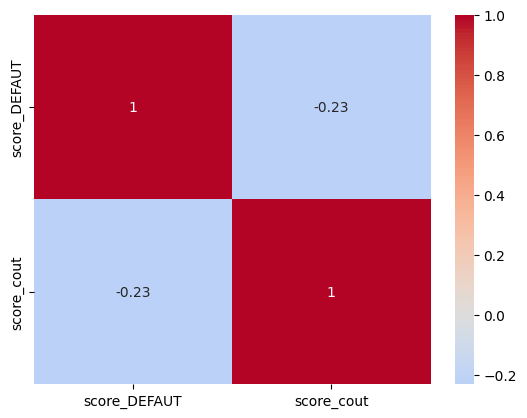

In [37]:
import seaborn as sns
sns.heatmap(df[["score_DEFAUT", "score_cout"]].corr(), annot=True, cmap='coolwarm', center=0)

 Nous constatons que il y'a pas de corrélation entre ces deux variables

<img src='./oc_logo.png' width=15px /> On souhaite identifier les écoles ayant un fort potentiel économique pour notre client, voici la liste des critères que l'on recherche :
- Nombre important d'étudiants
- Prix élevé de la formation
- Taux d'admission faible

Utilisez les scores calculés précédemment pour construire un nouvel indicateur (`SCORE_SYNT`) synthétisant ces propriétés.

In [38]:
# Le score globale 
df["SCORE_SYNT"] =  0.3 * df["SCORE_POP"] + 0.3 * df["score_cout"] + 0.4 * df["score_DEFAUT"]

In [39]:
df.head()

,ID,NOM,VILLE,ETAT,LATITUDE,LONGITUDE,A_DISTANCE_SEULEMENT,NOMBRE_ETUDIANTS,AGE_ENTREE,COUT_MOYEN_ANNEE_ACADEMIE,TAUX_ADMISSION,DEFAUT_PAIEMENT_2ANNEES,DEFAUT_PAIEMENT_3ANNEES,NB_NAN,DEFAUT_PAIEMENT,NOMBRE_DEMANDES,SCORE_POP,score_cout,score_DEFAUT,SCORE_SYNT
3230,351000,Middle Tennessee State University,Murfreesboro,TN,35.848005,-86.360618,0.0,4613.0,22.357583,20718.0,0.9353,0.085,0.103,0,0.0940,4932.107345,0.055176,0.818932,0.9060,0.624632
8,831000,Auburn University at Montgomery,Montgomery,AL,32.367360,-86.177544,0.0,1175.0,22.199804,18291.0,0.9281,0.090,0.104,0,0.0970,1266.027368,0.014080,0.845202,0.9030,0.618985
9,100900,Auburn University,Auburn,AL,32.599378,-85.488258,0.0,3032.0,20.516796,31282.0,0.7543,0.045,0.036,0,0.0405,4019.620841,0.044948,0.704584,0.9595,0.608659
10,101200,Birmingham-Southern College,Birmingham,AL,33.513774,-86.850552,0.0,208.0,19.644796,52176.0,0.5666,0.085,0.048,0,0.0665,367.102012,0.004003,0.478422,0.9335,0.518127
21,962107,Herzing University-Birmingham,Birmingham,AL,33.468466,-86.832465,0.0,4088.0,31.289941,26128.0,0.9500,0.117,0.127,0,0.1220,4303.157895,0.048126,0.760372,0.8780,0.593749


<img src='./oc_logo.png' width=15px /> Donnez la liste des 15 établissements les mieux classés par rapport à `SCORE_SYNT`

In [40]:
# Donnez la liste des 15 établissements les mieux classés par rapport à `SCORE_SYNT`
#df.sort_values("SCORE_SYNT", ascending=False).head(15)[["NOM", "ETAT","SCORE_POP","TAUX_ADMISSION","SCORE_SYNT"]]
df[["NOM", "ETAT","SCORE_POP","TAUX_ADMISSION","SCORE_SYNT"]].sort_values("SCORE_SYNT", ascending=False).head(15)

,NOM,ETAT,SCORE_POP,TAUX_ADMISSION,SCORE_SYNT
5900,University of Phoenix-Arizona,AZ,1.0,0.7022,0.946699
5901,University of Phoenix-California,CA,1.0,0.7022,0.946381
5907,University of Phoenix-Nevada,NV,1.0,0.7022,0.944124
5910,University of Phoenix-Texas,TX,1.0,0.7022,0.943855
5909,University of Phoenix-Tennessee,TN,1.0,0.7022,0.939601
5908,University of Phoenix-North Carolina,NC,1.0,0.7022,0.939601
5911,University of Phoenix-Virginia,VA,1.0,0.7022,0.939601
5912,University of Phoenix-Pennsylvania,PA,1.0,0.7022,0.939601
5902,University of Phoenix-Colorado,CO,1.0,0.7022,0.939601
5903,University of Phoenix-Florida,FL,1.0,0.7022,0.939601


<img src='./oc_logo.png' width=15px /> Quels sont les 15 villes ayant les plus forts scores totaux ?

In [41]:
df.groupby("VILLE")["SCORE_POP"].mean().sort_values(ascending=False).head(15)

VILLE
Tukwila               1.000000
Cordova               1.000000
Lone Tree             1.000000
Urbandale             0.418943
Sellersburg           0.412701
Hershey               0.250203
Schuylkill Haven      0.238481
The Woodlands         0.231685
Mont Alto             0.230650
New Kensington        0.219465
Lemont Furnace        0.218373
Suitland              0.215146
Palm Beach Gardens    0.215146
Scott Depot           0.215146
Huntersville          0.215146
Name: SCORE_POP, dtype: float64

<img src='./oc_logo.png' width=15px /> Et les états ?

In [42]:
df.groupby("ETAT")["SCORE_SYNT"].mean().sort_values(ascending=False).head(15)

ETAT
PR    0.649216
HI    0.626724
AZ    0.625929
ND    0.625084
FL    0.623686
NM    0.622850
GA    0.621005
WY    0.620670
MT    0.620252
UT    0.619380
AL    0.616651
NV    0.616552
SD    0.616098
LA    0.615760
NE    0.615611
Name: SCORE_SYNT, dtype: float64

Coincidence avec le nombre d'établissements à distance ? ;)

<img src='./oc_logo.png' width=15px /> Conclusions

Vous venez d'identifier un ensemble de villes potentiellement intéressantes pour un développement commercial, il faut maintenant les présenter à votre client pour le convaincre de la pertinence de vos analyses !

Dans cet exercice vous avez appris à nettoyer et explorer un jeu de données pour en extraire des données exploitables (ici à travers les scores). Essayez toujours de présenter des résultats simples à comprendre, ici les scores sont directement issus des indicateurs, ils sont bornés entre 0 et 1.

<img src='./oc_logo.png' width=15px /> Perspectives d'amélioration

Nous n'avons pas exploité toutes les données, par exemple pour illustrer nos analyses il est indispensable de créer des visualisations graphiques avec matplotlib et seaborn, et pourquoi pas faire une carte interactive (avec folium) en utilisant lattitude et longitude.

In [43]:
! pip install folium


[notice] A new release of pip is available: 24.0 -> 25.1.1
[notice] To update, run: C:\Users\ngale\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [44]:
# Filtrer les lignes avec des coordonnées valides
df_valid = df.dropna(subset=["LATITUDE", "LONGITUDE"])

# Créer la carte (centrée sur la moyenne des points valides par exemple)
import folium
centre = [df_valid["LATITUDE"].mean(), df_valid["LONGITUDE"].mean()]
ma_carte = folium.Map(location=centre, zoom_start=6)

# Ajouter les marqueurs valides
for index, row in df_valid.iterrows():
    folium.Marker(
        location=[row["LATITUDE"], row["LONGITUDE"]],
        popup=f"{row['NOM']}<br>Score: {row['SCORE_SYNT']:.2f}",
        tooltip=row["NOM"],
    ).add_to(ma_carte)

# Afficher la carte dans un notebook Jupyter
ma_carte


In [45]:
import geopandas as gpd
import pandas as pd
import folium
from folium.features import GeoJsonTooltip
import branca.colormap as cm

# Nettoyer les données
df["SCORE_SYNT"] = pd.to_numeric(df["SCORE_SYNT"], errors="coerce")
df["LATITUDE"] = pd.to_numeric(df["LATITUDE"], errors="coerce")
df["LONGITUDE"] = pd.to_numeric(df["LONGITUDE"], errors="coerce")

# Supprimer les lignes invalides
df_clean = df.dropna(subset=["SCORE_SYNT", "LATITUDE", "LONGITUDE"])

# Créer une échelle de couleurs SANS ERREUR
min_score = df_clean["SCORE_SYNT"].min()
max_score = df_clean["SCORE_SYNT"].max()
color_scale = cm.linear.Reds_09.scale(min_score, max_score).to_step(n=10)
color_scale.caption = "Score synthétique des villes"

# Créer la carte centrée sur la France
m = folium.Map(location=[46.5, 2.5], zoom_start=6, tiles="CartoDB positron")

# Ajouter les marqueurs
for _, row in df_clean.iterrows():
    score = row['SCORE_SYNT']
    couleur = color_scale(score)
    folium.CircleMarker(
        location=[row["LATITUDE"], row["LONGITUDE"]],
        radius=7,
        color=couleur,
        fill=True,
        fill_color=couleur,
        fill_opacity=0.7,
        popup=f"{row['VILLE']}<br>Score: {score:.2f}",
        tooltip=row['VILLE']
    ).add_to(m)

# Ajouter la légende
color_scale.add_to(m)

# Afficher la carte dans un notebook
m
